<a href="https://colab.research.google.com/github/riti1302/OCR-correction/blob/master/SpellCheck.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install tensorflow==1.1.0

     |████████████████████████████████| 31.4MB 99kB/s 
  Found existing installation: tensorflow 2.2.0
    Uninstalling tensorflow-2.2.0:
      Successfully uninstalled tensorflow-2.2.0


In [ ]:
!unzip "books.zip" -d "./"

Archive:  books.zip
   creating: ./books/
  inflating: ./books/Alices_Adventures_in_Wonderland_by_Lewis_Carroll.rtf  
  inflating: ./books/Anna_Karenina_by_Leo_Tolstoy.rtf  
  inflating: ./books/David_Copperfield_by_Charles_Dickens.rtf  
  inflating: ./books/Don_Quixote_by_Miguel_de_Cervantes.rtf  
  inflating: ./books/Dracula_by_Bram_Stoker.rtf  
  inflating: ./books/Emma_by_Jane_Austen.rtf  
  inflating: ./books/Frankenstein_by_Mary_Shelley.rtf  
  inflating: ./books/Great_Expectations_by_Charles_Dickens.rtf  
  inflating: ./books/Grimms_Fairy_Tales_by_The_Brothers_Grimm.rtf  
  inflating: ./books/Metamorphosis_by_Franz_Kafka.rtf  
  inflating: ./books/Oliver_Twist_by_Charles_Dickens.rtf  
  inflating: ./books/Pride_and_Prejudice_by_Jane_Austen.rtf  
  inflating: ./books/The_Adventures_of_Sherlock_Holmes_by_Arthur_Conan_Doyle.rtf  
  inflating: ./books/The_Adventures_of_Tom_Sawyer_by_Mark_Twain.rtf  
  inflating: ./books/The_Count_of_Monte_Cristo_by_Alexandre_Dumas.rtf  
  inflating:

In [ ]:
# importing the packages
import pandas as pd
import numpy as np
import tensorflow as tf
import os
from os import listdir
from os.path import isfile, join
from collections import namedtuple
from tensorflow.python.layers.core import Dense
from tensorflow.python.ops.rnn_cell_impl import _zero_state_tensors
import time
import re
from sklearn.model_selection import train_test_split

/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:455: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:456: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:457: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:458: FutureWarning: Passing (type, 1) or 

In [ ]:
# Method to Load the book from his files
def load_book(path):    
    input_file = os.path.join(path)
    with open(input_file) as f:
        book = f.read()
    return book

In [ ]:
# Collect all of the book file names
path = 'books/'
book_files = [f for f in listdir(path) if isfile(join(path, f))]
book_files

['The_Yellow_Wallpaper_by_Charlotte_Perkins_Gilman.rtf',
 'Anna_Karenina_by_Leo_Tolstoy.rtf',
 'Dracula_by_Bram_Stoker.rtf',
 'Don_Quixote_by_Miguel_de_Cervantes.rtf',
 'Metamorphosis_by_Franz_Kafka.rtf',
 'Oliver_Twist_by_Charles_Dickens.rtf',
 'Emma_by_Jane_Austen.rtf',
 'Great_Expectations_by_Charles_Dickens.rtf',
 'The_Adventures_of_Sherlock_Holmes_by_Arthur_Conan_Doyle.rtf',
 'The_Picture_of_Dorian_Gray_by_Oscar_Wilde.rtf',
 'David_Copperfield_by_Charles_Dickens.rtf',
 'The_Count_of_Monte_Cristo_by_Alexandre_Dumas.rtf',
 'Frankenstein_by_Mary_Shelley.rtf',
 'The_Prince_by_Nicolo_Machiavelli.rtf',
 'Grimms_Fairy_Tales_by_The_Brothers_Grimm.rtf',
 'The_Adventures_of_Tom_Sawyer_by_Mark_Twain.rtf',
 'Through_the_Looking_Glass_by_Lewis_Carroll.rtf',
 'Pride_and_Prejudice_by_Jane_Austen.rtf',
 'The_Romance_of_Lust_by_Anonymous.rtf',
 'Alices_Adventures_in_Wonderland_by_Lewis_Carroll.rtf']

In [ ]:
# Load the books using the file names
books = []
for book in book_files:
    books.append(load_book(path+book))
books

['{\\rtf1\\ansi\\ansicpg1252\\cocoartf1404\\cocoasubrtf470\n{\\fonttbl\\f0\\fmodern\\fcharset0 Courier;}\n{\\colortbl;\\red255\\green255\\blue255;\\red0\\green0\\blue0;}\n\\margl1440\\margr1440\\vieww10800\\viewh8400\\viewkind0\n\\deftab720\n\\pard\\pardeftab720\\sl280\\partightenfactor0\n\n\\f0\\fs24 \\cf2 \\expnd0\\expndtw0\\kerning0\n\\outl0\\strokewidth0 \\strokec2 Project Gutenberg\'s The Yellow Wallpaper, by Charlotte Perkins Gilman\\\n\\\nThis eBook is for the use of anyone anywhere at no cost and with\\\nalmost no restrictions whatsoever.  You may copy it, give it away or\\\nre-use it under the terms of the Project Gutenberg License included\\\nwith this eBook or online at www.gutenberg.org\\\n\\\n\\\nTitle: The Yellow Wallpaper\\\n\\\nAuthor: Charlotte Perkins Gilman\\\n\\\nPosting Date: November 25, 2008 [EBook #1952]\\\nRelease Date: November, 1999\\\nLast Corrected: January 31, 2011\\\n\\\nLanguage: English\\\n\\\n\\\n*** START OF THIS PROJECT GUTENBERG EBOOK THE YELLOW WAL

In [ ]:
# Getting number of words in each book 
for i in range(len(books)):
    print("The number of {} words in book of named {}.".format(len(books[i].split()), book_files[i]))

The number of 9463 words in book of named The_Yellow_Wallpaper_by_Charlotte_Perkins_Gilman.rtf.
The number of 361612 words in book of named Anna_Karenina_by_Leo_Tolstoy.rtf.
The number of 166996 words in book of named Dracula_by_Bram_Stoker.rtf.
The number of 433993 words in book of named Don_Quixote_by_Miguel_de_Cervantes.rtf.
The number of 25395 words in book of named Metamorphosis_by_Franz_Kafka.rtf.
The number of 165188 words in book of named Oliver_Twist_by_Charles_Dickens.rtf.
The number of 163109 words in book of named Emma_by_Jane_Austen.rtf.
The number of 191598 words in book of named Great_Expectations_by_Charles_Dickens.rtf.
The number of 110213 words in book of named The_Adventures_of_Sherlock_Holmes_by_Arthur_Conan_Doyle.rtf.
The number of 83657 words in book of named The_Picture_of_Dorian_Gray_by_Oscar_Wilde.rtf.
The number of 113452 words in book of named David_Copperfield_by_Charles_Dickens.rtf.
The number of 480495 words in book of named The_Count_of_Monte_Cristo_by_Al

In [ ]:
# Method to clean the data
def clean_text(text):    
    text = re.sub(r'\n', ' ', text) 
    text = re.sub(r'[{}@_*>()\\#%+=\[\]]','', text)
    text = re.sub('a0','', text)
    text = re.sub('\'92t','\'t', text)
    text = re.sub('\'92s','\'s', text)
    text = re.sub('\'92m','\'m', text)
    text = re.sub('\'92ll','\'ll', text)
    text = re.sub('\'91','', text)
    text = re.sub('\'92','', text)
    text = re.sub('\'93','', text)
    text = re.sub('\'94','', text)
    text = re.sub('\.','. ', text)
    text = re.sub('\!','! ', text)
    text = re.sub('\?','? ', text)
    text = re.sub(' +',' ', text)
    return text
# Clean the text of the books
clean_books = []
for book in books:
    clean_books.append(clean_text(book))
clean_books

['rtf1ansiansicpg1252cocoartf1404cocoasubrtf470 fonttblf0fmodernfcharset0 Courier; colortbl;red255green255blue255;red0green0blue0; margl1440margr1440vieww10800viewh8400viewkind0 deftab720 pardpardeftab720sl280partightenfactor0 f0fs24 cf2 expnd0expndtw0kerning0 outl0strokewidth0 strokec2 Project Gutenberg\'s The Yellow Wallpaper, by Charlotte Perkins Gilman This eBook is for the use of anyone anywhere at no cost and with almost no restrictions whatsoever. You may copy it, give it away or re-use it under the terms of the Project Gutenberg License included with this eBook or online at www. gutenberg. org Title: The Yellow Wallpaper Author: Charlotte Perkins Gilman Posting Date: November 25, 2008 EBook 1952 Release Date: November, 1999 Last Corrected: January 31, 2011 Language: English START OF THIS PROJECT GUTENBERG EBOOK THE YELLOW WALLPAPER Produced by An Anonymous Volunteer THE YELLOW WALLPAPER By Charlotte Perkins Gilman It is very seldom that mere ordinary people like John and myself

In [ ]:
# Create a dictionary to convert the vocabulary (characters) to integers
vocab_to_int = {}
count = 0
for book in clean_books:
    for character in book:
        if character not in vocab_to_int:
            vocab_to_int[character] = count
            count += 1

# Add special tokens to vocab_to_int
codes = ['<PAD>','<EOS>','<GO>']
for code in codes:
    vocab_to_int[code] = count
    count += 1

In [ ]:
# Check the size of vocabulary and all of the values
vocab_size = len(vocab_to_int)
print("The vocabulary contains {} characters.".format(vocab_size))
print(sorted(vocab_to_int))

The vocabulary contains 78 characters.
[' ', '!', '"', '$', '&', "'", ',', '-', '.', '/', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', ':', ';', '<EOS>', '<GO>', '<PAD>', '?', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z']


In [ ]:
# Create another dictionary to convert integers to their respective characters
int_to_vocab = {}
for character, value in vocab_to_int.items():
    int_to_vocab[value] = character

In [ ]:
# Split the text from the books into sentences 
sentences = []
for book in clean_books:
    for sentence in book.split('. '):
        sentences.append(sentence + '.')
print("Total number of sentences are {} .".format(len(sentences)))
sentences

Total number of sentences are 133494 .


["rtf1ansiansicpg1252cocoartf1404cocoasubrtf470 fonttblf0fmodernfcharset0 Courier; colortbl;red255green255blue255;red0green0blue0; margl1440margr1440vieww10800viewh8400viewkind0 deftab720 pardpardeftab720sl280partightenfactor0 f0fs24 cf2 expnd0expndtw0kerning0 outl0strokewidth0 strokec2 Project Gutenberg's The Yellow Wallpaper, by Charlotte Perkins Gilman This eBook is for the use of anyone anywhere at no cost and with almost no restrictions whatsoever.",
 'You may copy it, give it away or re-use it under the terms of the Project Gutenberg License included with this eBook or online at www.',
 'gutenberg.',
 'org Title: The Yellow Wallpaper Author: Charlotte Perkins Gilman Posting Date: November 25, 2008 EBook 1952 Release Date: November, 1999 Last Corrected: January 31, 2011 Language: English START OF THIS PROJECT GUTENBERG EBOOK THE YELLOW WALLPAPER Produced by An Anonymous Volunteer THE YELLOW WALLPAPER By Charlotte Perkins Gilman It is very seldom that mere ordinary people like John

In [ ]:
# Find the length of each sentence
lengths = []
for sentence in sentences:
    lengths.append(len(sentence))
length_df = pd.DataFrame(lengths, columns=["counts"])
length_df.describe()

,counts
count,133494.000000
mean,120.474418
std,116.765852
min,1.000000
25%,46.000000
50%,92.000000
75%,159.000000
max,8906.000000


{986: 1, 944: 1, 1287: 1, 976: 1, 4513: 1, 1701: 1, 876: 1, 829: 1, 994: 1, 1032: 1, 914: 1, 1196: 1, 841: 1, 855: 1, 687: 1, 742: 1, 1162: 1, 978: 1, 1504: 1, 998: 1, 1812: 1, 794: 1, 979: 1, 1070: 1, 987: 1, 820: 1, 881: 1, 808: 1, 1095: 1, 731: 1, 787: 1, 793: 1, 884: 1, 1056: 1, 1144: 1, 922: 1, 1820: 1, 1119: 1, 1089: 1, 1132: 1, 1479: 1, 1050: 1, 1660: 1, 823: 1, 955: 1, 1093: 1, 950: 1, 1121: 1, 807: 1, 1707: 1, 718: 1, 832: 1, 1784: 1, 641: 1, 773: 1, 706: 1, 1078: 1, 1009: 1, 1071: 1, 852: 1, 953: 1, 872: 1, 803: 1, 1641: 1, 893: 1, 895: 1, 933: 1, 965: 1, 867: 1, 949: 1, 984: 1, 1025: 1, 1201: 1, 1302: 1, 809: 1, 740: 1, 968: 1, 1015: 1, 817: 1, 814: 1, 1023: 1, 1729: 1, 1227: 1, 850: 1, 1044: 1, 1211: 1, 935: 1, 1775: 1, 1236: 1, 1521: 1, 1041: 1, 1432: 1, 1066: 1, 1688: 1, 1396: 1, 1546: 1, 1420: 1, 1088: 1, 8906: 1, 1159: 1, 1059: 1, 1385: 1, 942: 1, 824: 1, 1096: 1, 1573: 1, 1341: 1, 870: 1, 1204: 1, 988: 1, 698: 1, 1232: 1, 896: 1, 1099: 1, 669: 1, 813: 1, 931: 1, 1065: 

<BarContainer object of 1019 artists>

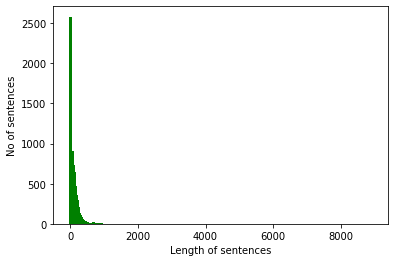

In [ ]:
from collections import Counter
import matplotlib.pyplot as plt

frequency = dict(Counter(lengths))
frequency = {k: v for k, v in sorted(frequency.items(), key=lambda item: item[1])}
print(frequency)
plt.xlabel('Length of sentences')
plt.ylabel('No of sentences')
plt.bar(frequency.keys(), frequency.values(), 100.0, color='g')

In [ ]:
# Limit the data we will use to train our model
max_length = 92
min_length = 15

good_sentences = []

for sentence in sentences:
    if len(sentence) <= max_length and len(sentence) >= min_length:
        good_sentences.append(sentence)

print("Total number of {} sentences to train and test our model.".format(len(good_sentences)))
good_sentences

Total number of 57637 sentences to train and test our model.


['John is practical in the extreme.',
 'Personally, I disagree with their ideas.',
 'Personally, I believe that congenial work, with excitement and change, would do me good.',
 'So I will let it alone and talk about the house.',
 'There were greenhouses, too, but they are all broken now.',
 'I get unreasonably angry with John sometimes.',
 "I'm sure I never used to be so sensitive.",
 'I think it is due to this nervous condition.',
 "I don't like our room a bit.",
 'He is very careful and loving, and hardly lets me stir without special direction.',
 '" So we took the nursery at the top of the house.',
 "The paint and paper look as if a boys' school had used it.",
 'I never saw a worse paper in my life.',
 'One of those sprawling flamboyant patterns committing every artistic sin.',
 'It is a dull yet lurid orange in some places, a sickly sulphur tint in others.',
 'No wonder the children hated it! I should hate it myself if I had to live in this room long.',
 'There comes John, and I mu

In [ ]:
# Convert sentences to integers
int_sentences = []

for sentence in good_sentences:
    int_sentence = []
    for character in sentence:
        int_sentence.append(vocab_to_int[character])
    int_sentences.append(int_sentence)

In [ ]:
# Split the data into training and testing sentences
training, testing = train_test_split(int_sentences, test_size = 0.15, random_state = 2)

print("Number of training sentences:", len(training))
print("Number of testing sentences:", len(testing))

Number of training sentences: 48991
Number of testing sentences: 8646


In [ ]:
# Sort the sentences by length to reduce padding, which will allow the model to train faster
training_sorted = []
testing_sorted = []

for i in range(min_length, max_length+1):
    for sentence in training:
        if len(sentence) == i:
            training_sorted.append(sentence)
    for sentence in testing:
        if len(sentence) == i:
            testing_sorted.append(sentence)

In [ ]:
# Check to ensure the sentences have been selected and sorted correctly
for i in range(500):
    print(training_sorted[i], len(training_sorted[i]))

[66, 19, 66, 48, 13, 39, 19, 4, 19, 1, 24, 7, 5, 10, 42] 15
[37, 13, 16, 39, 19, 7, 6, 19, 7, 1, 39, 19, 65, 0, 42] 15
[32, 23, 10, 10, 13, 1, 1, 40, 19, 1, 13, 19, 21, 23, 42] 15
[12, 19, 55, 8, 1, 13, 17, 23, 0, 39, 19, 12, 19, 9, 42] 15
[54, 23, 28, 4, 0, 22, 35, 6, 19, 47, 7, 4, 0, 40, 42] 15
[65, 7, 6, 8, 24, 7, 23, 2, 19, 70, 44, 58, 58, 58, 42] 15
[36, 4, 30, 23, 19, 1, 24, 23, 19, 10, 20, 4, 6, 6, 42] 15
[38, 23, 6, 1, 13, 5, 19, 4, 5, 22, 19, 65, 0, 6, 42] 15
[48, 13, 39, 19, 1, 13, 19, 17, 23, 19, 6, 16, 0, 23, 42] 15
[66, 19, 66, 58, 19, 1, 0, 16, 6, 1, 19, 40, 13, 16, 42] 15
[54, 24, 23, 19, 8, 0, 4, 28, 20, 6, 19, 5, 13, 28, 42] 15
[32, 0, 7, 27, 4, 1, 23, 20, 40, 64, 19, 37, 23, 6, 42] 15
[49, 34, 49, 51, 36, 55, 48, 19, 36, 55, 19, 65, 51, 54, 42] 15
[41, 4, 0, 13, 5, 19, 47, 4, 5, 10, 20, 4, 0, 6, 42] 15
[66, 46, 19, 21, 4, 5, 19, 7, 6, 19, 24, 16, 0, 1, 42] 15
[37, 13, 16, 19, 7, 21, 9, 20, 13, 0, 23, 19, 21, 23, 42] 15
[25, 20, 4, 0, 4, 62, 19, 6, 4, 7, 22, 19, 65, 0,

In [ ]:
# Method to Relocate, remove, or add characters to create spelling mistakes
letters = ['a','b','c','d','e','f','g','h','i','j','k','l','m',
           'n','o','p','q','r','s','t','u','v','w','x','y','z',]

def noise_maker(sentence, threshold):   
    
    noisy_sentence = []
    i = 0
    while i < len(sentence):
        random = np.random.uniform(0,1,1)
        # Most characters will be correct since the threshold value is high
        if random < threshold:
            noisy_sentence.append(sentence[i])
        else:
            new_random = np.random.uniform(0,1,1)
            # ~33% chance characters will swap locations
            if new_random > 0.67:
                if i == (len(sentence) - 1):
                    # If last character in sentence, it will not be typed
                    continue
                else:
                    # if any other character, swap order with following character
                    noisy_sentence.append(sentence[i+1])
                    noisy_sentence.append(sentence[i])
                    i += 1
            # ~33% chance an extra lower case letter will be added to the sentence
            elif new_random < 0.33:
                random_letter = np.random.choice(letters, 1)[0]
                noisy_sentence.append(vocab_to_int[random_letter])
                noisy_sentence.append(sentence[i])
            # ~33% chance a character will not be typed
            else:
                pass     
        i += 1
    return noisy_sentence

# Check to ensure noise_maker is making mistakes correctly.
threshold = 0.9
for sentence in training_sorted[:5]:
    print(sentence)
    print(noise_maker(sentence, threshold))
    print()

[66, 19, 66, 48, 13, 39, 19, 4, 19, 1, 24, 7, 5, 10, 42]
[66, 19, 66, 48, 13, 39, 4, 19, 1, 24, 7, 5, 10, 42]

[37, 13, 16, 39, 19, 7, 6, 19, 7, 1, 39, 19, 65, 0, 42]
[37, 13, 16, 39, 7, 6, 19, 7, 1, 2, 39, 19, 0, 65, 42]

[32, 23, 10, 10, 13, 1, 1, 40, 19, 1, 13, 19, 21, 23, 42]
[32, 23, 10, 13, 1, 1, 40, 19, 1, 13, 19, 21, 23, 42]

[12, 19, 55, 8, 1, 13, 17, 23, 0, 39, 19, 12, 19, 9, 42]
[12, 19, 55, 8, 13, 17, 23, 0, 39, 12, 19, 9, 42]

[54, 23, 28, 4, 0, 22, 35, 6, 19, 47, 7, 4, 0, 40, 42]
[54, 23, 28, 4, 0, 22, 35, 6, 19, 47, 7, 4, 40, 0, 42]



In [ ]:
# Method to create placeholder
def model_inputs():  
    
    with tf.name_scope('inputs'):
        inputs = tf.placeholder(tf.int32, [None, None], name='inputs')
    with tf.name_scope('targets'):
        targets = tf.placeholder(tf.int32, [None, None], name='targets')
    keep_prob = tf.placeholder(tf.float32, name='keep_prob')
    inputs_length = tf.placeholder(tf.int32, (None,), name='inputs_length')
    targets_length = tf.placeholder(tf.int32, (None,), name='targets_length')
    max_target_length = tf.reduce_max(targets_length, name='max_target_len')

    return inputs, targets, keep_prob, inputs_length, targets_length, max_target_length

In [ ]:
# Remove the last word id from each batch and concat the <GO> to the begining of each batch
def process_encoding_input(targets, vocab_to_int, batch_size):   
    
    with tf.name_scope("process_encoding"):
        ending = tf.strided_slice(targets, [0, 0], [batch_size, -1], [1, 1])
        dec_input = tf.concat([tf.fill([batch_size, 1], vocab_to_int['<GO>']), ending], 1)

    return dec_input


In [ ]:
# Create the encoding layer
def encoding_layer(rnn_size, sequence_length, num_layers, rnn_inputs, keep_prob, direction):   
    
    if direction == 1:
        with tf.name_scope("RNN_Encoder_Cell_1D"):
            for layer in range(num_layers):
                with tf.variable_scope('encoder_{}'.format(layer)):
                    lstm = tf.contrib.rnn.LSTMCell(rnn_size)

                    drop = tf.contrib.rnn.DropoutWrapper(lstm, 
                                                         input_keep_prob = keep_prob)

                    enc_output, enc_state = tf.nn.dynamic_rnn(drop, 
                                                              rnn_inputs,
                                                              sequence_length,
                                                              dtype=tf.float32)

            return enc_output, enc_state
        
        
    if direction == 2:
        with tf.name_scope("RNN_Encoder_Cell_2D"):
            for layer in range(num_layers):
                with tf.variable_scope('encoder_{}'.format(layer)):
                    cell_fw = tf.contrib.rnn.LSTMCell(rnn_size)
                    cell_fw = tf.contrib.rnn.DropoutWrapper(cell_fw, 
                                                            input_keep_prob = keep_prob)

                    cell_bw = tf.contrib.rnn.LSTMCell(rnn_size)
                    cell_bw = tf.contrib.rnn.DropoutWrapper(cell_bw, 
                                                            input_keep_prob = keep_prob)

                    enc_output, enc_state = tf.nn.bidirectional_dynamic_rnn(cell_fw, 
                                                                            cell_bw, 
                                                                            rnn_inputs,
                                                                            sequence_length,
                                                                            dtype=tf.float32)
            # Join outputs since we are using a bidirectional RNN
            enc_output = tf.concat(enc_output,2)
            # Use only the forward state because the model can't use both states at once
            return enc_output, enc_state[0]

In [ ]:
# Create the training logits
def training_decoding_layer(dec_embed_input, targets_length, dec_cell, initial_state, output_layer, 
                            vocab_size, max_target_length):    
    
    with tf.name_scope("Training_Decoder"):
        training_helper = tf.contrib.seq2seq.TrainingHelper(inputs=dec_embed_input,
                                                            sequence_length=targets_length,
                                                            time_major=False)

        training_decoder = tf.contrib.seq2seq.BasicDecoder(dec_cell,
                                                           training_helper,
                                                           initial_state,
                                                           output_layer) 

        training_logits, _ = tf.contrib.seq2seq.dynamic_decode(training_decoder,
                                                               output_time_major=False,
                                                               impute_finished=True,
                                                               maximum_iterations=max_target_length)
        return training_logits

In [ ]:
# Create the inference logits
def inference_decoding_layer(embeddings, start_token, end_token, dec_cell, initial_state, output_layer,
                             max_target_length, batch_size):    
    
    with tf.name_scope("Inference_Decoder"):
        start_tokens = tf.tile(tf.constant([start_token], dtype=tf.int32), [batch_size], name='start_tokens')

        inference_helper = tf.contrib.seq2seq.GreedyEmbeddingHelper(embeddings,
                                                                    start_tokens,
                                                                    end_token)

        inference_decoder = tf.contrib.seq2seq.BasicDecoder(dec_cell,
                                                            inference_helper,
                                                            initial_state,
                                                            output_layer)

        inference_logits, _ = tf.contrib.seq2seq.dynamic_decode(inference_decoder,
                                                                output_time_major=False,
                                                                impute_finished=True,
                                                                maximum_iterations=max_target_length)

        return inference_logits

In [ ]:
# Create the decoding cell and attention for the training and inference decoding layers
def decoding_layer(dec_embed_input, embeddings, enc_output, enc_state, vocab_size, inputs_length, targets_length, 
                   max_target_length, rnn_size, vocab_to_int, keep_prob, batch_size, num_layers, direction):  
    
    with tf.name_scope("RNN_Decoder_Cell"):
        for layer in range(num_layers):
            with tf.variable_scope('decoder_{}'.format(layer)):
                lstm = tf.contrib.rnn.LSTMCell(rnn_size)
                dec_cell = tf.contrib.rnn.DropoutWrapper(lstm, 
                                                         input_keep_prob = keep_prob)
    
    output_layer = Dense(vocab_size,
                         kernel_initializer = tf.truncated_normal_initializer(mean = 0.0, stddev=0.1))
    
    attn_mech = tf.contrib.seq2seq.BahdanauAttention(rnn_size,
                                                  enc_output,
                                                  inputs_length,
                                                  normalize=False,
                                                  name='BahdanauAttention')
    
    with tf.name_scope("Attention_Wrapper"):
        dec_cell = tf.contrib.seq2seq.DynamicAttentionWrapper(dec_cell,
                                                              attn_mech,
                                                              rnn_size)
    
    initial_state = tf.contrib.seq2seq.DynamicAttentionWrapperState(enc_state,
                                                                    _zero_state_tensors(rnn_size, 
                                                                                        batch_size, 
                                                                                        tf.float32))

    with tf.variable_scope("decode"):
        training_logits = training_decoding_layer(dec_embed_input, 
                                                  targets_length, 
                                                  dec_cell, 
                                                  initial_state,
                                                  output_layer,
                                                  vocab_size, 
                                                  max_target_length)
    with tf.variable_scope("decode", reuse=True):
        inference_logits = inference_decoding_layer(embeddings,  
                                                    vocab_to_int['<GO>'], 
                                                    vocab_to_int['<EOS>'],
                                                    dec_cell, 
                                                    initial_state, 
                                                    output_layer,
                                                    max_target_length,
                                                    batch_size)

    return training_logits, inference_logits

In [ ]:
# Use the previous functions to create the training and inference logits
def seq2seq_model(inputs, targets, keep_prob, inputs_length, targets_length, max_target_length, 
                  vocab_size, rnn_size, num_layers, vocab_to_int, batch_size, embedding_size, direction):    
    
    enc_embeddings = tf.Variable(tf.random_uniform([vocab_size, embedding_size], -1, 1))
    enc_embed_input = tf.nn.embedding_lookup(enc_embeddings, inputs)
    enc_output, enc_state = encoding_layer(rnn_size, inputs_length, num_layers, 
                                           enc_embed_input, keep_prob, direction)
    
    dec_embeddings = tf.Variable(tf.random_uniform([vocab_size, embedding_size], -1, 1))
    dec_input = process_encoding_input(targets, vocab_to_int, batch_size)
    dec_embed_input = tf.nn.embedding_lookup(dec_embeddings, dec_input)
    
    training_logits, inference_logits  = decoding_layer(dec_embed_input, 
                                                        dec_embeddings,
                                                        enc_output,
                                                        enc_state, 
                                                        vocab_size, 
                                                        inputs_length, 
                                                        targets_length, 
                                                        max_target_length,
                                                        rnn_size, 
                                                        vocab_to_int, 
                                                        keep_prob, 
                                                        batch_size,
                                                        num_layers,
                                                        direction)
    
    return training_logits, inference_logits

In [ ]:
# Pad sentences with <PAD> so that each sentence of a batch has the same length
def pad_sentence_batch(sentence_batch):    
    max_sentence = max([len(sentence) for sentence in sentence_batch])
    return [sentence + [vocab_to_int['<PAD>']] * (max_sentence - len(sentence)) for sentence in sentence_batch]

In [ ]:
# Batch sentences, noisy sentences, and the lengths of their sentences together.With each epoch, sentences will receive new mistakes"
def get_batches(sentences, batch_size, threshold):    
    for batch_i in range(0, len(sentences)//batch_size):
        start_i = batch_i * batch_size
        sentences_batch = sentences[start_i:start_i + batch_size]
        
        sentences_batch_noisy = []
        for sentence in sentences_batch:
            sentences_batch_noisy.append(noise_maker(sentence, threshold))
            
        sentences_batch_eos = []
        for sentence in sentences_batch:
            sentence.append(vocab_to_int['<EOS>'])
            sentences_batch_eos.append(sentence)
            
        pad_sentences_batch = np.array(pad_sentence_batch(sentences_batch_eos))
        pad_sentences_noisy_batch = np.array(pad_sentence_batch(sentences_batch_noisy))
        
        # Need the lengths for the _lengths parameters
        pad_sentences_lengths = []
        for sentence in pad_sentences_batch:
            pad_sentences_lengths.append(len(sentence))
        
        pad_sentences_noisy_lengths = []
        for sentence in pad_sentences_noisy_batch:
            pad_sentences_noisy_lengths.append(len(sentence))
        
        yield pad_sentences_noisy_batch, pad_sentences_batch, pad_sentences_noisy_lengths, pad_sentences_lengths

In [ ]:
# The default parameters
epochs = 100
batch_size = 128
num_layers = 2
rnn_size = 512
embedding_size = 128
learning_rate = 0.0005
direction = 2
threshold = 0.95
keep_probability = 0.75

In [ ]:
# Method to build the graph
def build_graph(keep_prob, rnn_size, num_layers, batch_size, learning_rate, embedding_size, direction):

    tf.reset_default_graph()
    
    # Load the model inputs    
    inputs, targets, keep_prob, inputs_length, targets_length, max_target_length = model_inputs()

    # Create the training and inference logits
    training_logits, inference_logits = seq2seq_model(tf.reverse(inputs, [-1]),
                                                      targets, 
                                                      keep_prob,   
                                                      inputs_length,
                                                      targets_length,
                                                      max_target_length,
                                                      len(vocab_to_int)+1,
                                                      rnn_size, 
                                                      num_layers, 
                                                      vocab_to_int,
                                                      batch_size,
                                                      embedding_size,
                                                      direction)

    # Create tensors for the training logits and inference logits
    training_logits = tf.identity(training_logits.rnn_output, 'logits')

    with tf.name_scope('predictions'):
        predictions = tf.identity(inference_logits.sample_id, name='predictions')
        tf.summary.histogram('predictions', predictions)

    # Create the weights for sequence_loss
    masks = tf.sequence_mask(targets_length, max_target_length, dtype=tf.float32, name='masks')
    
    with tf.name_scope("cost"):
        # Loss function
        cost = tf.contrib.seq2seq.sequence_loss(training_logits,
                                                targets, 
                                                masks)
        tf.summary.scalar('cost', cost)

    with tf.name_scope("optimze"):
        optimizer = tf.train.AdamOptimizer(learning_rate)

        # Gradient Clipping
        gradients = optimizer.compute_gradients(cost)
        capped_gradients = [(tf.clip_by_value(grad, -5., 5.), var) for grad, var in gradients if grad is not None]
        train_op = optimizer.apply_gradients(capped_gradients)

    # Merge all of the summaries
    merged = tf.summary.merge_all()    

    # Export the nodes 
    export_nodes = ['inputs', 'targets', 'keep_prob', 'cost', 'inputs_length', 'targets_length',
                    'predictions', 'merged', 'train_op','optimizer']
    Graph = namedtuple('Graph', export_nodes)
    local_dict = locals()
    graph = Graph(*[local_dict[each] for each in export_nodes])

    return graph

In [ ]:
# Train the RNN
def train(model, epochs, log_string):   
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())

        # Used to determine when to stop the training early
        testing_loss_summary = []

        # Keep track of which batch iteration is being trained
        iteration = 0
        
        display_step = 30 # The progress of the training will be displayed after every 30 batches
        stop_early = 0 
        stop = 3 # If the batch_loss_testing does not decrease in 3 consecutive checks, stop training
        per_epoch = 3 # Test the model 3 times per epoch
        testing_check = (len(training_sorted)//batch_size//per_epoch)-1

        print()
        print("Training Model: {}".format(log_string))

        train_writer = tf.summary.FileWriter('./logs/train/{}'.format(log_string), sess.graph)
        test_writer = tf.summary.FileWriter('./logs/test/{}'.format(log_string))

        for epoch_i in range(1, epochs+1): 
            batch_loss = 0
            batch_time = 0
            
            for batch_i, (input_batch, target_batch, input_length, target_length) in enumerate(
                    get_batches(training_sorted, batch_size, threshold)):
                start_time = time.time()

                summary, loss, _ = sess.run([model.merged,
                                             model.cost, 
                                             model.train_op], 
                                             {model.inputs: input_batch,
                                              model.targets: target_batch,
                                              model.inputs_length: input_length,
                                              model.targets_length: target_length,
                                              model.keep_prob: keep_probability})


                batch_loss += loss
                end_time = time.time()
                batch_time += end_time - start_time

                # Record the progress of training
                train_writer.add_summary(summary, iteration)

                iteration += 1

                if batch_i % display_step == 0 and batch_i > 0:
                    print('Epoch {:>3}/{} Batch {:>4}/{} - Loss: {:>6.3f}, Seconds: {:>4.2f}'
                          .format(epoch_i,
                                  epochs, 
                                  batch_i, 
                                  len(training_sorted) // batch_size, 
                                  batch_loss / display_step, 
                                  batch_time))
                    batch_loss = 0
                    batch_time = 0

                #### Testing ####
                if batch_i % testing_check == 0 and batch_i > 0:
                    batch_loss_testing = 0
                    batch_time_testing = 0
                    for batch_i, (input_batch, target_batch, input_length, target_length) in enumerate(
                            get_batches(testing_sorted, batch_size, threshold)):
                        start_time_testing = time.time()
                        summary, loss = sess.run([model.merged,
                                                  model.cost], 
                                                     {model.inputs: input_batch,
                                                      model.targets: target_batch,
                                                      model.inputs_length: input_length,
                                                      model.targets_length: target_length,
                                                      model.keep_prob: 1})

                        batch_loss_testing += loss
                        end_time_testing = time.time()
                        batch_time_testing += end_time_testing - start_time_testing

                        # Record the progress of testing
                        test_writer.add_summary(summary, iteration)

                    n_batches_testing = batch_i + 1
                    print('Testing Loss: {:>6.3f}, Seconds: {:>4.2f}'
                          .format(batch_loss_testing / n_batches_testing, 
                                  batch_time_testing))
                    
                    batch_time_testing = 0

                    # If the batch_loss_testing is at a new minimum, save the model
                    testing_loss_summary.append(batch_loss_testing)
                    if batch_loss_testing <= min(testing_loss_summary):
                        print('New Record!') 
                        stop_early = 0
                        checkpoint = "./{}.ckpt".format(log_string)
                        saver = tf.train.Saver()
                        saver.save(sess, checkpoint)

                    else:
                        print("No Improvement.")
                        stop_early += 1
                        if stop_early == stop:
                            break

            if stop_early == stop:
                print("Stopping Training.")
                break

In [ ]:
# Train the model with the desired tuning parameters
for keep_probability in [0.75]:
    for num_layers in [2]:
        for threshold in [0.95]:
            log_string = 'kp={},nl={},th={}'.format(keep_probability,
                                                    num_layers,
                                                    threshold) 
            model = build_graph(keep_probability, rnn_size, num_layers, batch_size, 
                                learning_rate, embedding_size, direction)
            train(model, epochs, log_string)


Training Model: kp=0.75,nl=2,th=0.95
Epoch   1/100 Batch   30/382 - Loss:  2.935, Seconds: 331.52
Epoch   1/100 Batch   60/382 - Loss:  1.874, Seconds: 474.70
Epoch   1/100 Batch   90/382 - Loss:  1.316, Seconds: 628.40
Epoch   1/100 Batch  120/382 - Loss:  0.847, Seconds: 769.41
Testing Loss:  3.204, Seconds: 1400.38
New Record!
Epoch   1/100 Batch  150/382 - Loss:  0.642, Seconds: 915.31
Epoch   1/100 Batch  180/382 - Loss:  0.414, Seconds: 1091.27
Epoch   1/100 Batch  210/382 - Loss:  1.038, Seconds: 1278.14
Epoch   1/100 Batch  240/382 - Loss:  0.560, Seconds: 1499.56
Testing Loss:  1.510, Seconds: 1549.76
New Record!
Epoch   1/100 Batch  270/382 - Loss:  0.340, Seconds: 1727.57
Epoch   1/100 Batch  300/382 - Loss:  0.301, Seconds: 1974.35
Epoch   1/100 Batch  330/382 - Loss:  0.281, Seconds: 2248.68
Epoch   1/100 Batch  360/382 - Loss:  0.996, Seconds: 2578.48
Testing Loss:  1.190, Seconds: 1598.21
New Record!
Epoch   2/100 Batch   30/382 - Loss:  0.482, Seconds: 329.79
Epoch   2

In [ ]:
# Prepare the text for the model
def text_to_ints(text):  
    
    text = clean_text(text)
    return [vocab_to_int[word] for word in text]

In [ ]:
# Create your own sentence or use one from the dataset
text = "The first days of her existence in th country were vrey hard for Dolly.."
text = text_to_ints(text)

checkpoint = "./kp=0.75,nl=2,th=0.95.ckpt"

model = build_graph(keep_probability, rnn_size, num_layers, batch_size, learning_rate, embedding_size, direction) 

with tf.Session() as sess:
    # Load saved model
    saver = tf.train.Saver()
    saver.restore(sess, checkpoint)
    
    #Multiply by batch_size to match the model's input parameters
    answer_logits = sess.run(model.predictions, {model.inputs: [text]*batch_size, 
                                                 model.inputs_length: [len(text)]*batch_size,
                                                 model.targets_length: [len(text)+1], 
                                                 model.keep_prob: [1.0]})[0]

In [ ]:
# Summary
print('\nSummary')
print('Response Words: {}'.format("".join([int_to_vocab[i] for i in answer_logits if i != pad])))